In [ ]:
# torch vision si detectron2
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

In [ ]:
import os
import time
import math
import json
import random
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab.patches import cv2_imshow

import numpy as np
import pandas as pd
import cv2

from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog
from detectron2.data import DatasetCatalog
from detectron2.utils.visualizer import Visualizer
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import ColorMode

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
json_annotation_path = "/content/drive/MyDrive/DataScience/final_project/unpacked/export/_annotations.coco.json"
#no_cars_json_annotation_path = "/content/drive/MyDrive/DataScience/final_project/unpacked/export/no_cars_json.coco.json"
images_path = "/content/drive/MyDrive/DataScience/final_project/unpacked/export/"

#yolo_annotation_path = "/content/drive/MyDrive/DataScience/final_project/YOLO/self_driving_car/export/labels/"
#yolo_images_path = "/content/drive/MyDrive/DataScience/final_project/YOLO/self_driving_car/export/images/"

# calea de unde incarcam video pentru conversie:
#input_loc = "/content/drive/MyDrive/DataScience/final_project/video/samples/sample1.mp4"
#calea unde salvam frame-urile
output_loc = "/content/drive/MyDrive/DataScience/final_project/video/sample_frames/sample1_frames"

# calea unde salvam parametri modelului
output_path = "/content/drive/MyDrive/DataScience/final_project/output"

# configurarea si weights pentru Detectron2
model_config = "./detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_1x.yaml"
#model_zoo_weigths = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"

device = "cpu" #  modify this to "cuda" if GPU is available

In [ ]:
register_coco_instances("cars", {}, json_annotation_path, images_path)
cars_metadata = MetadataCatalog.get("cars")
dataset_dicts = DatasetCatalog.get("cars")

Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_config)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = (
    128
)  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 11
cfg.OUTPUT_DIR = output_path
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   
cfg.DATASETS.TEST = ("cars", )
predictor = DefaultPredictor(cfg)

00001.jpg


/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


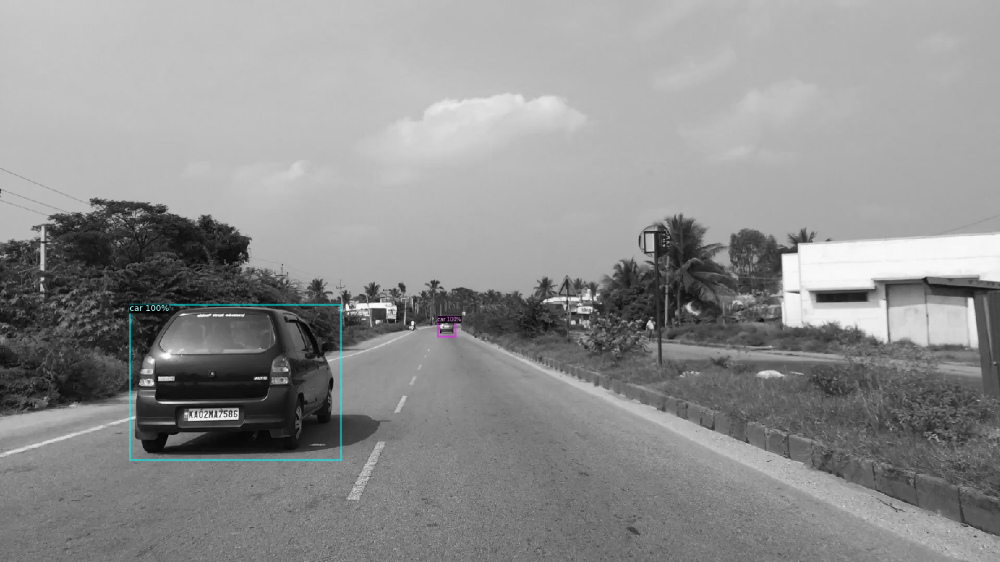

00002.jpg


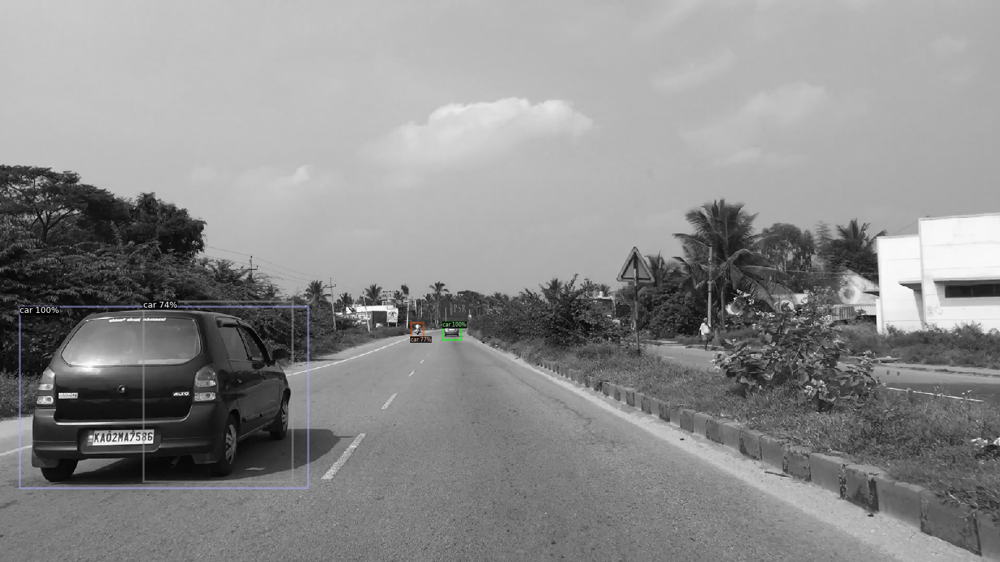

00003.jpg


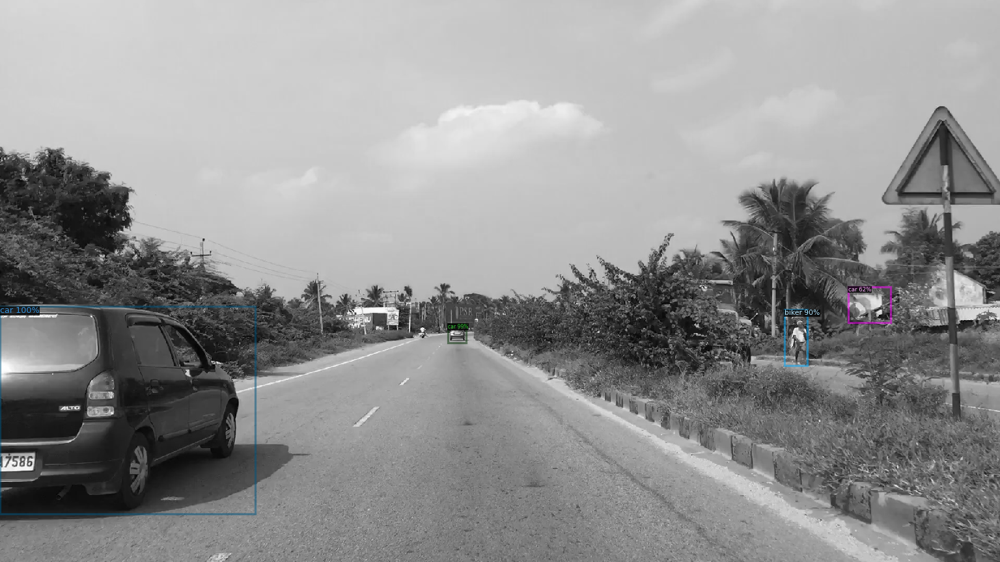

00004.jpg


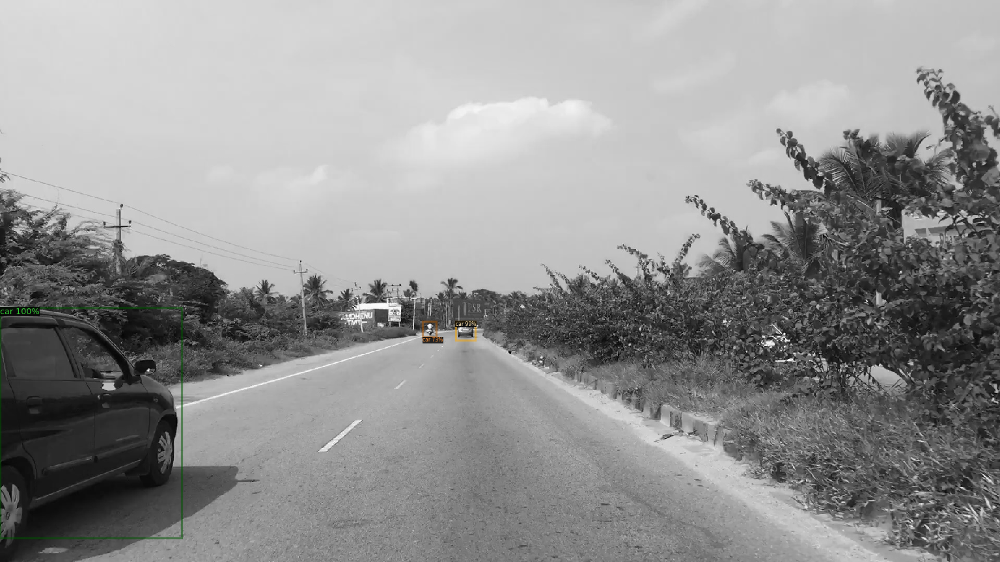

00005.jpg


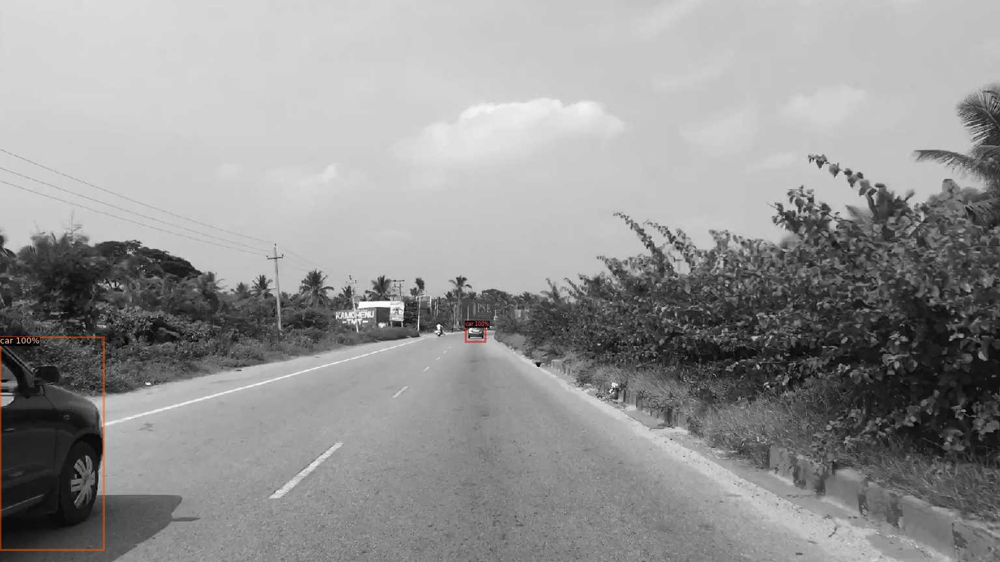

00006.jpg


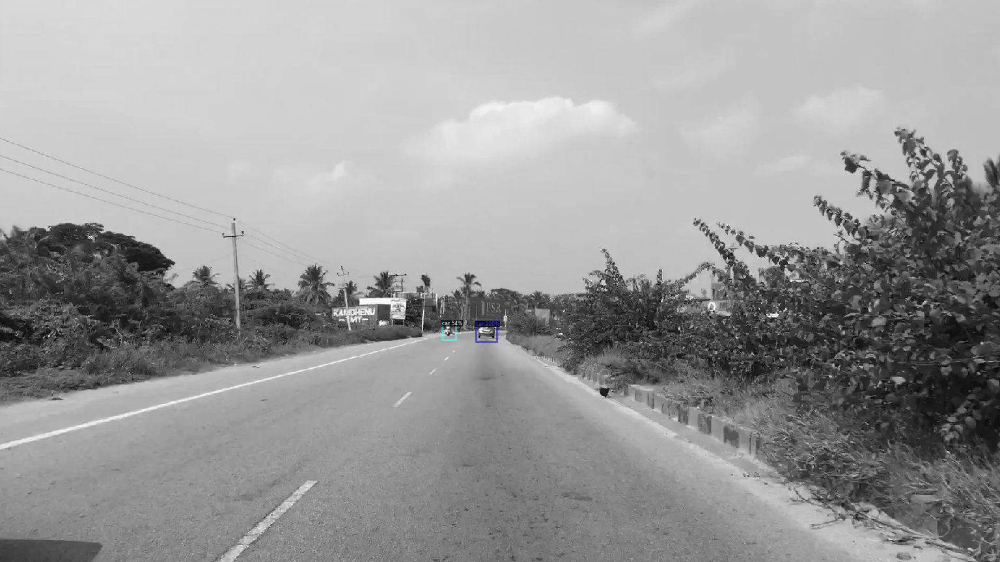

00007.jpg


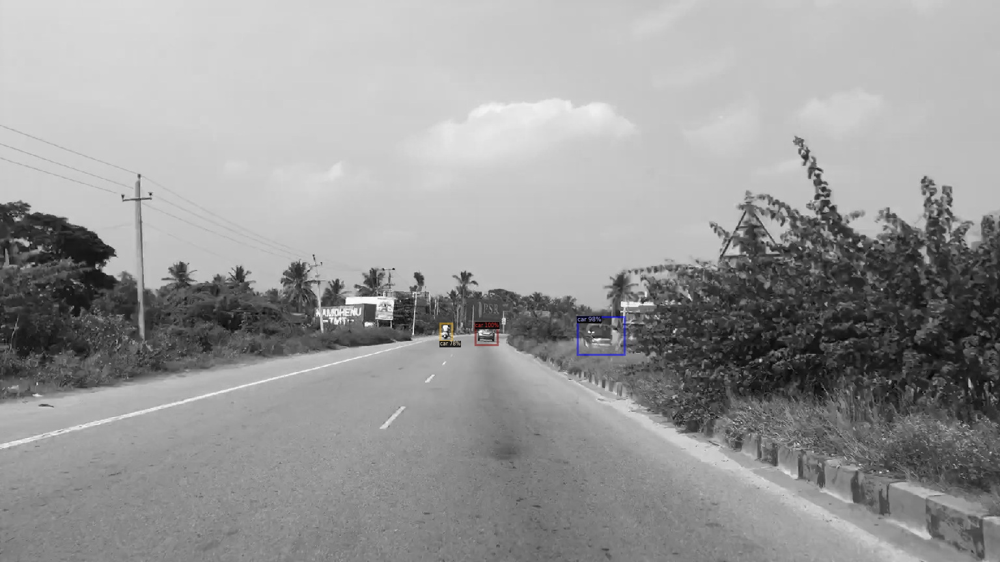

00008.jpg


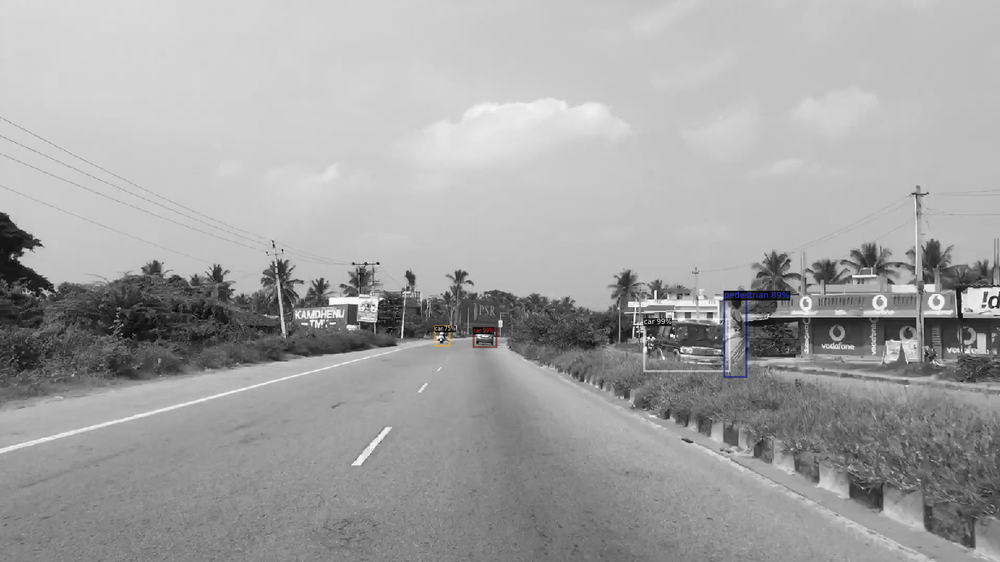

00009.jpg


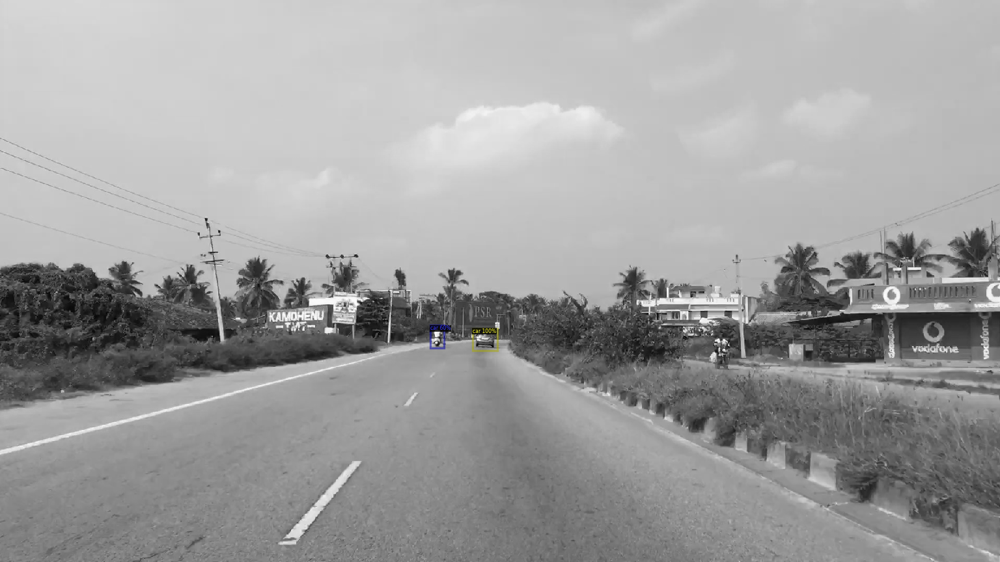

00010.jpg


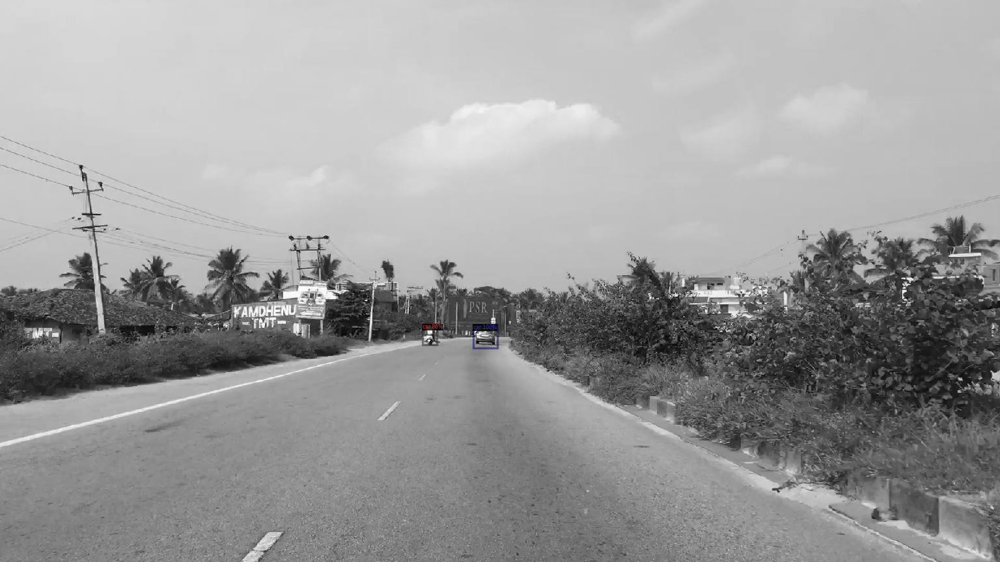

00011.jpg


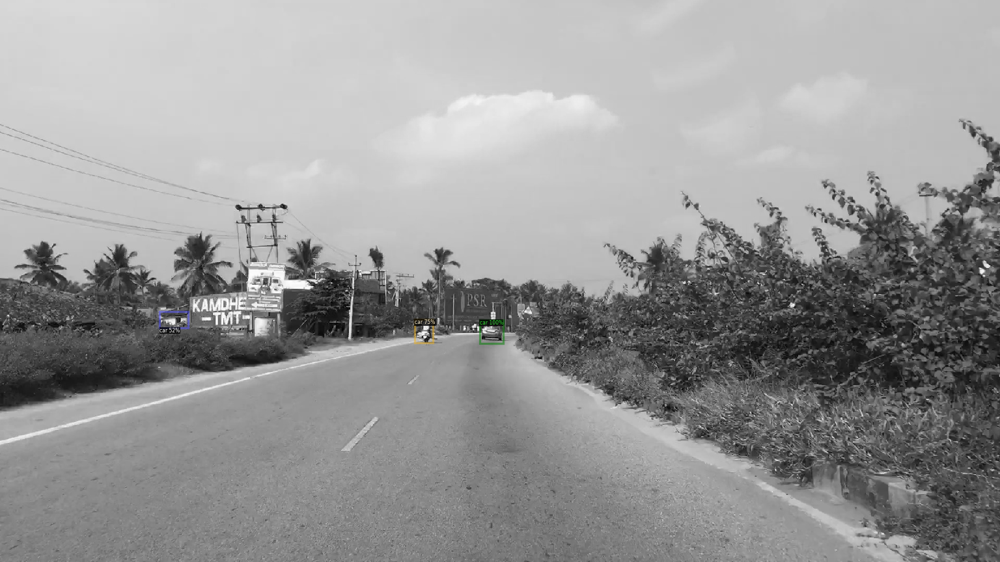

00012.jpg


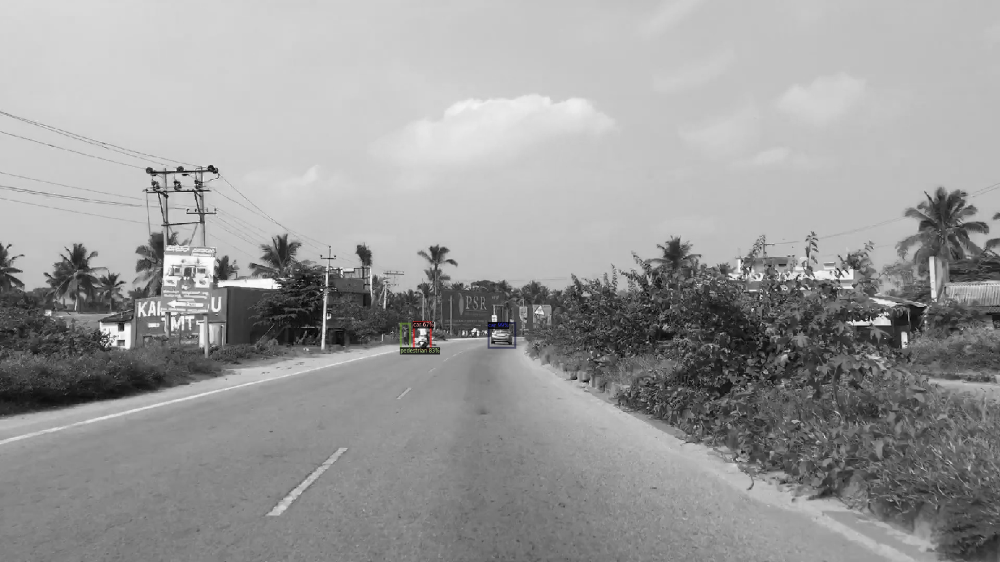

00013.jpg


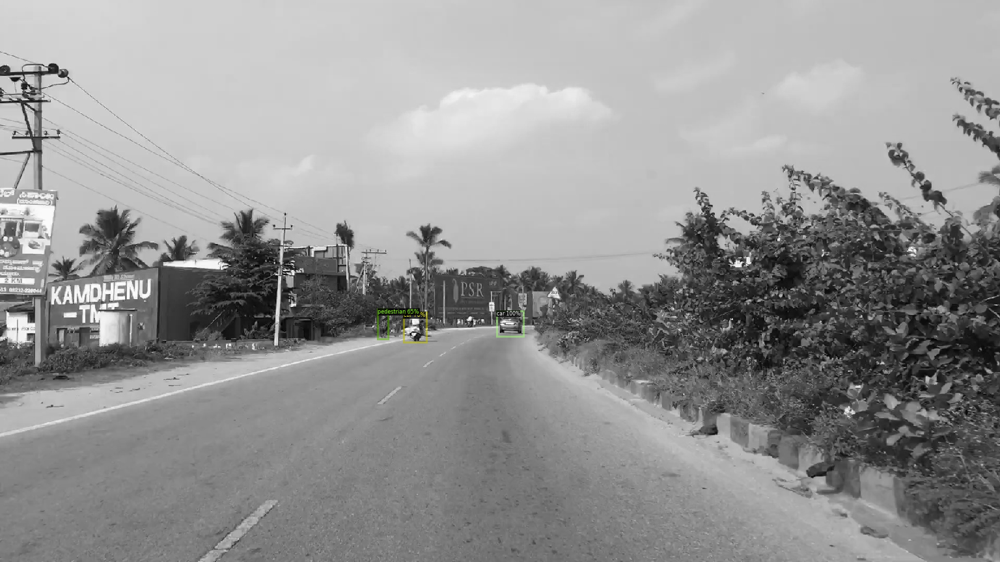

00014.jpg


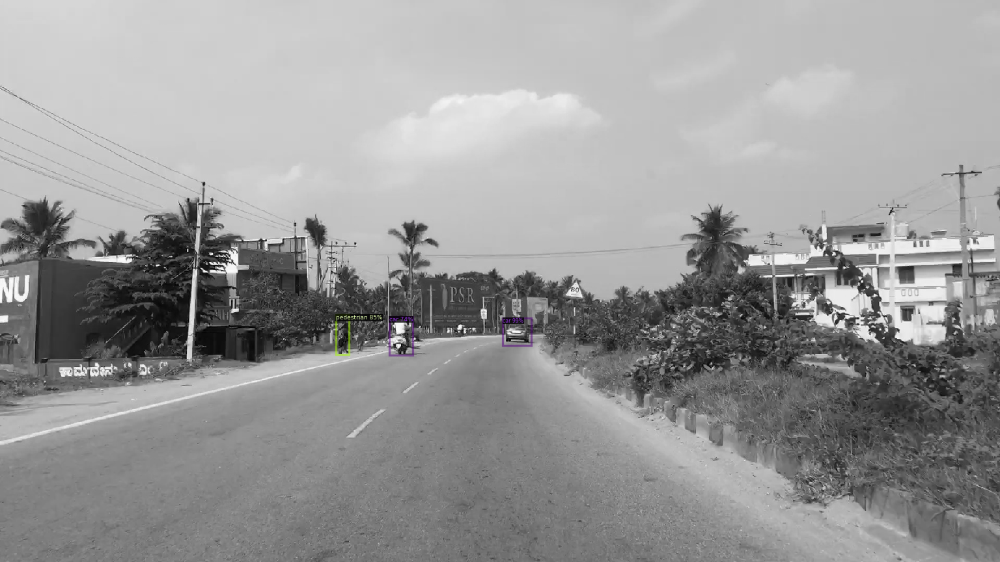

00015.jpg


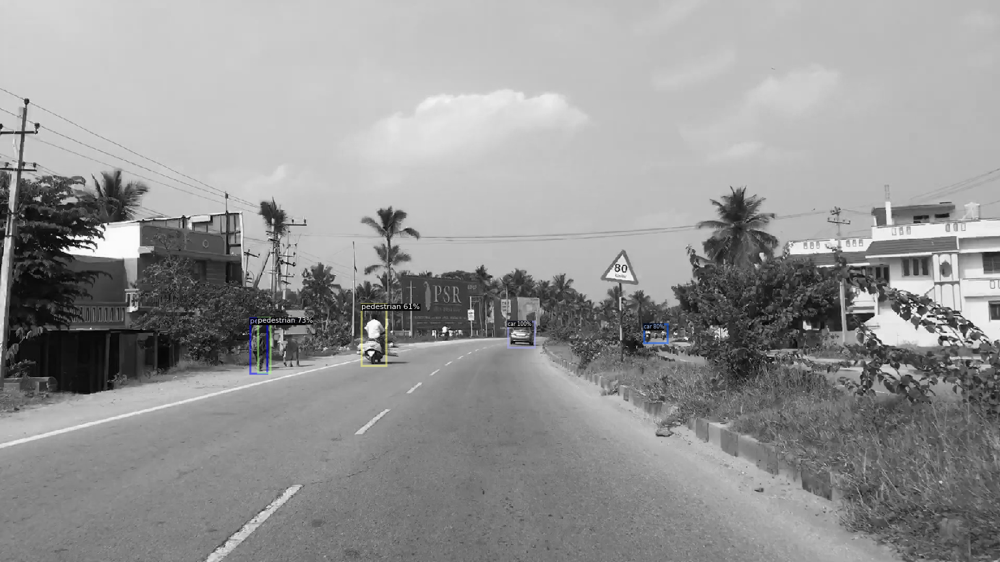

00016.jpg


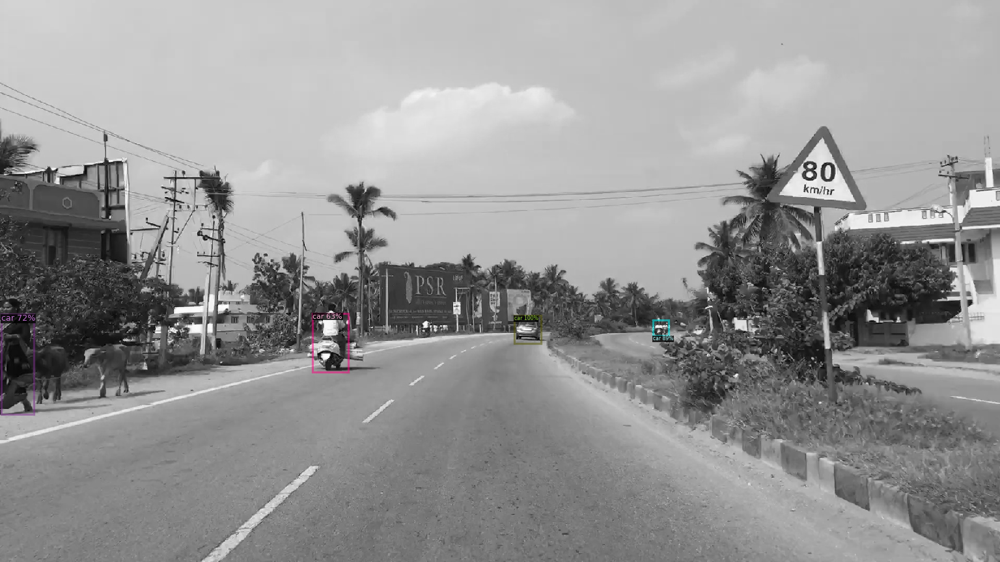

00017.jpg


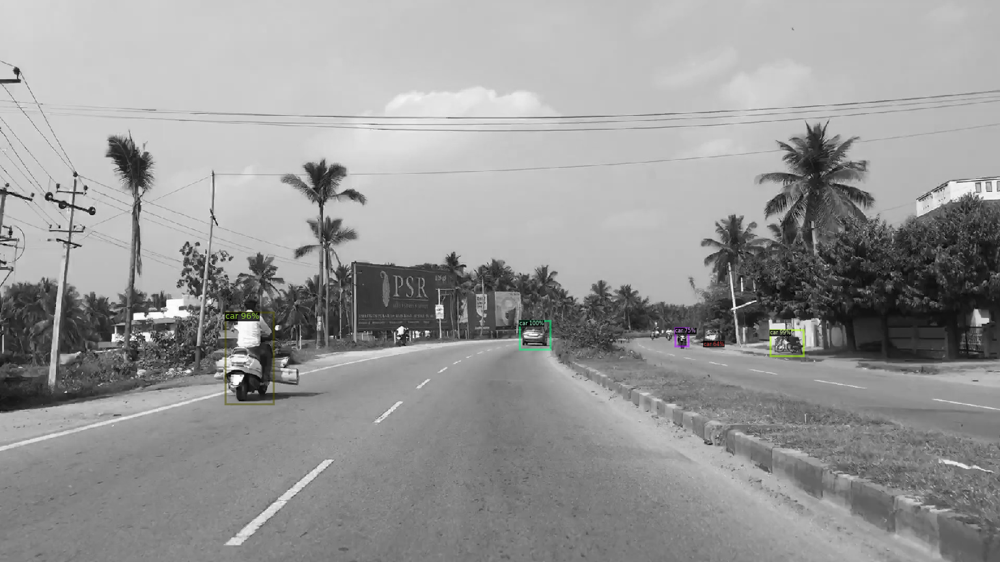

00018.jpg


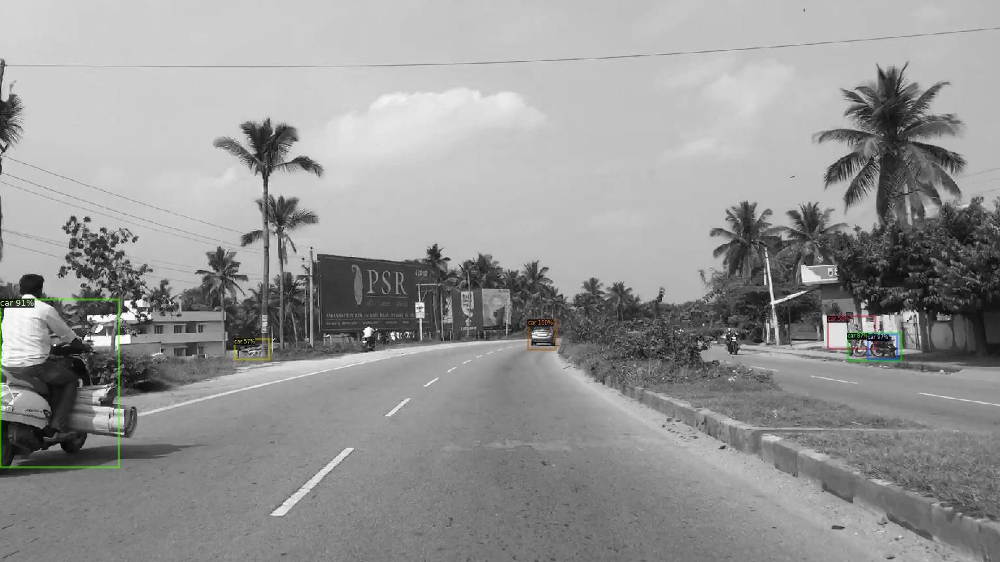

00019.jpg


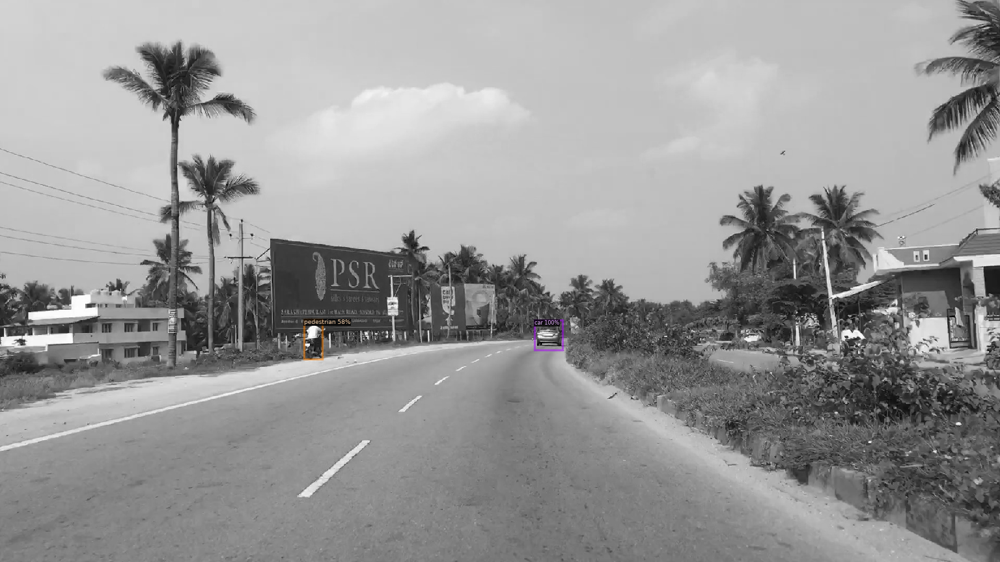

00020.jpg


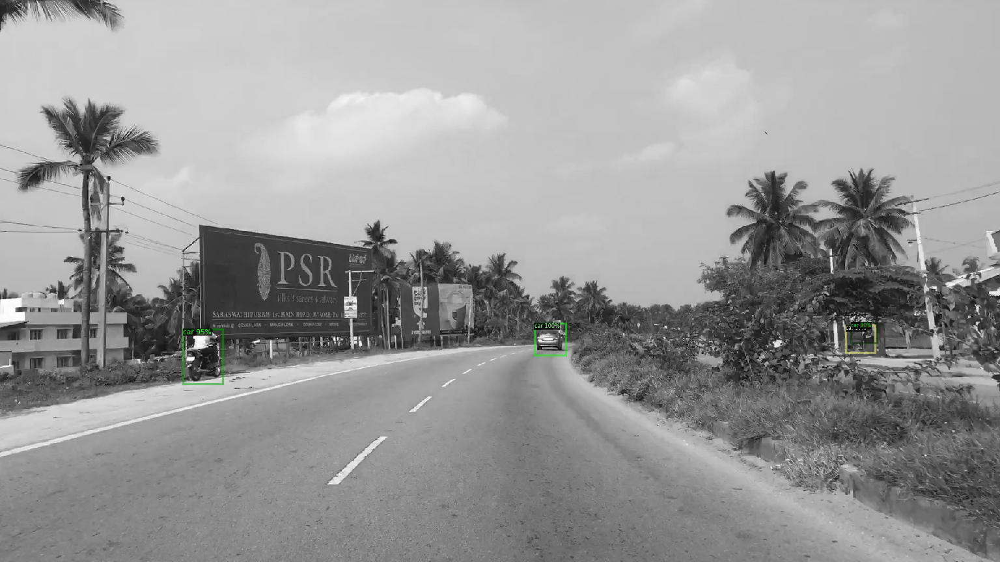

In [ ]:
numarator = 1
for file in os.listdir(output_loc):
  if numarator <= 20:
    im = cv2.imread(os.path.join(output_loc, file))
    print(file)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=cars_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])
    numarator += 1
  else:
    break

In [ ]:
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.15,fps:6.70


In [ ]:
!pip install youtube-dl
!youtube-dl https://www.youtube.com/watch?v=KBsqQez-O4w -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

In [ ]:
%run detectron2_repo/demo/demo.py --config-file detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl

[02/02 11:30:49 detectron2]: Arguments: Namespace(confidence_threshold=0.6, config_file='detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml', input=None, opts=['MODEL.WEIGHTS', 'https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl'], output='video-output.mkv', video_input='video-clip.mp4', webcam=False)
[02/02 11:30:50 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl ...
[02/02 11:30:50 fvcore.common.checkpoint]: [Checkpointer] Loading from /root/.torch/iopath_cache/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl ...
[02/02 11:30:50 fvcore.common.checkpoint]: Reading a file from 'Detectron2 Model Zoo'


100%|██████████| 181/181 [00:45<00:00,  3.98it/s]


In [ ]:
%run detectron2_repo/demo/demo.py --config-file detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml --video-input /content/drive/MyDrive/DataScience/final_project/video/samples/sample1.mp4 --confidence-threshold 0.6 --output video-output2.mkv \
  --opts MODEL.WEIGHTS https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl

[02/02 11:44:39 detectron2]: Arguments: Namespace(confidence_threshold=0.6, config_file='detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml', input=None, opts=['MODEL.WEIGHTS', 'https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl'], output='video-output2.mkv', video_input='/content/drive/MyDrive/DataScience/final_project/video/samples/sample1.mp4', webcam=False)
[02/02 11:44:39 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl ...
[02/02 11:44:39 fvcore.common.checkpoint]: [Checkpointer] Loading from /root/.torch/iopath_cache/detectron2/COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl ...
[02/02 11:44:39 fvcore.common.checkpoint]: Reading a file from 'Detectron2 Model Zoo'


100%|██████████| 200/200 [01:09<00:00,  2.87it/s]
